# Project 3: Interactive Data Visualization

In [25]:
# Dependencies
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import plotly.graph_objects as go
# create html
import plotly.io as pio

# ignore warning
from warnings import filterwarnings
filterwarnings('ignore')

## Data preparation

### Goal: 

1. Select the appropriate data columns based on time series and geographical analysis requirements.
2. Address issues such as outliers, missing values, and format conversion.
3. Add necessary calculated columns.
4. Save the organized file in CSV format for data analysis and visualization.

In [26]:
# Load the data 
input_data_source = './Data_Source/AustinTXAccidentsData.csv'
raw_data = pd.read_csv(input_data_source, encoding='utf-8')
# review
raw_data

,ID,Source,Severity,Start_Time,End_Time,Start_Lat,Start_Lng,End_Lat,End_Lng,Distance(mi),...,Roundabout,Station,Stop,Traffic_Calming,Traffic_Signal,Turning_Loop,Sunrise_Sunset,Civil_Twilight,Nautical_Twilight,Astronomical_Twilight
0,A-261009,Source2,2,2016-11-30 16:03:54,2016-11-30 17:20:00,30.336502,-97.755646,NaN,NaN,0.010,...,False,False,False,False,False,False,Day,Day,Day,Day
1,A-261010,Source2,2,2016-11-30 16:32:18,2016-11-30 17:47:02,30.328165,-97.694305,NaN,NaN,0.000,...,False,False,False,False,False,False,Day,Day,Day,Day
2,A-261011,Source2,2,2016-11-30 16:31:45,2016-11-30 17:46:34,30.326077,-97.692307,NaN,NaN,0.000,...,False,True,False,False,True,False,Day,Day,Day,Day
3,A-261028,Source2,2,2016-11-30 17:11:22,2016-11-30 17:41:09,30.332523,-97.686707,NaN,NaN,0.010,...,False,False,False,False,False,False,Day,Day,Day,Day
4,A-261039,Source2,2,2016-11-30 17:16:42,2016-11-30 17:46:32,30.292852,-97.747017,NaN,NaN,0.010,...,False,False,False,False,False,False,Day,Day,Day,Day
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
96599,A-7775008,Source1,4,2019-08-18 04:03:40,2019-08-18 04:33:09,30.341300,-97.769622,30.341689,-97.782289,0.756,...,False,False,False,False,True,False,Night,Night,Night,Night
96600,A-7775009,Source1,4,2019-08-18 04:03:40,2019-08-18 04:33:09,30.341688,-97.782288,30.341300,-97.769622,0.756,...,False,False,False,False,False,False,Night,Night,Night,Night
96601,A-7775010,Source1,4,2019-08-18 05:18:40,2019-08-18 05:47:20,30.341688,-97.782288,30.341300,-97.769622,0.756,...,False,False,False,False,False,False,Night,Night,Night,Night
96602,A-7777478,Source1,2,2019-08-23 08:34:56,2019-08-23 09:04:52,30.437960,-97.777150,30.432260,-97.765890,0.778,...,False,False,False,False,False,False,Day,Day,Day,Day


In [27]:
raw_data.columns

Index(['ID', 'Source', 'Severity', 'Start_Time', 'End_Time', 'Start_Lat',
       'Start_Lng', 'End_Lat', 'End_Lng', 'Distance(mi)', 'Description',
       'Street', 'City', 'County', 'State', 'Zipcode', 'Country', 'Timezone',
       'Airport_Code', 'Weather_Timestamp', 'Temperature(F)', 'Wind_Chill(F)',
       'Humidity(%)', 'Pressure(in)', 'Visibility(mi)', 'Wind_Direction',
       'Wind_Speed(mph)', 'Precipitation(in)', 'Weather_Condition', 'Amenity',
       'Bump', 'Crossing', 'Give_Way', 'Junction', 'No_Exit', 'Railway',
       'Roundabout', 'Station', 'Stop', 'Traffic_Calming', 'Traffic_Signal',
       'Turning_Loop', 'Sunrise_Sunset', 'Civil_Twilight', 'Nautical_Twilight',
       'Astronomical_Twilight'],
      dtype='object')

### Note：

There are four columns (`Sunrise_Sunset`, `Civil_Twilight`, `Nautical_Twilight`, and `Astronomical_Twilight`), among which Sunrise_Sunset focuses on the specific times of sunrise and sunset. This column is the most direct and commonly used, so it is recommended to keep only this column.

In [28]:
raw_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 96604 entries, 0 to 96603
Data columns (total 46 columns):
 #   Column                 Non-Null Count  Dtype  
---  ------                 --------------  -----  
 0   ID                     96604 non-null  object 
 1   Source                 96604 non-null  object 
 2   Severity               96604 non-null  int64  
 3   Start_Time             96604 non-null  object 
 4   End_Time               96604 non-null  object 
 5   Start_Lat              96604 non-null  float64
 6   Start_Lng              96604 non-null  float64
 7   End_Lat                28158 non-null  float64
 8   End_Lng                28158 non-null  float64
 9   Distance(mi)           96604 non-null  float64
 10  Description            96604 non-null  object 
 11  Street                 96559 non-null  object 
 12  City                   96604 non-null  object 
 13  County                 96604 non-null  object 
 14  State                  96604 non-null  object 
 15  Zi

In [29]:
raw_data.describe()

,Severity,Start_Lat,Start_Lng,End_Lat,End_Lng,Distance(mi),Temperature(F),Wind_Chill(F),Humidity(%),Pressure(in),Visibility(mi),Wind_Speed(mph),Precipitation(in)
count,96604.000000,96604.000000,96604.000000,28158.000000,28158.000000,96604.000000,95446.000000,50955.000000,94848.000000,95699.000000,94876.000000,85524.000000,55192.000000
mean,2.088785,30.297193,-97.740694,30.294265,-97.738226,0.133442,71.288335,68.276395,62.655280,29.668862,9.245925,6.388303,0.008166
std,0.322085,0.084292,0.064397,0.085402,0.067412,0.508958,16.406792,18.896617,22.345977,0.393617,2.057099,4.233781,0.062324
min,1.000000,30.070537,-98.064842,29.638580,-98.214450,0.000000,1.000000,-17.000000,9.000000,28.320000,0.000000,0.000000,0.000000
25%,2.000000,30.233083,-97.771538,30.232232,-97.770927,0.000000,60.100000,56.000000,44.000000,29.320000,10.000000,3.500000,0.000000
50%,2.000000,30.286921,-97.735562,30.283755,-97.733925,0.000000,73.000000,72.000000,63.000000,29.650000,10.000000,6.000000,0.000000
75%,2.000000,30.363173,-97.697701,30.363435,-97.692470,0.048000,84.000000,82.000000,83.000000,29.990000,10.000000,8.100000,0.000000
max,4.000000,30.513420,-97.554594,30.520202,-97.532389,52.876000,136.400000,107.000000,100.000000,30.830000,46.000000,44.000000,2.550000


### Handling missing values

In [30]:
# Calculate the missing values
missing_values = (
    raw_data.isnull()
    .sum()
    .sort_values(ascending = False)
)

# Review
missing_values

End_Lat                  68446
End_Lng                  68446
Wind_Chill(F)            45649
Precipitation(in)        41412
Wind_Speed(mph)          11080
Wind_Direction            2610
Humidity(%)               1756
Visibility(mi)            1728
Weather_Condition         1610
Temperature(F)            1158
Pressure(in)               905
Weather_Timestamp          821
Street                      45
Airport_Code                 1
Traffic_Calming              0
Nautical_Twilight            0
Civil_Twilight               0
Sunrise_Sunset               0
Turning_Loop                 0
Crossing                     0
Traffic_Signal               0
Stop                         0
Station                      0
Give_Way                     0
Junction                     0
No_Exit                      0
Bump                         0
Roundabout                   0
Railway                      0
ID                           0
Amenity                      0
Source                       0
Timezone

<Axes: >

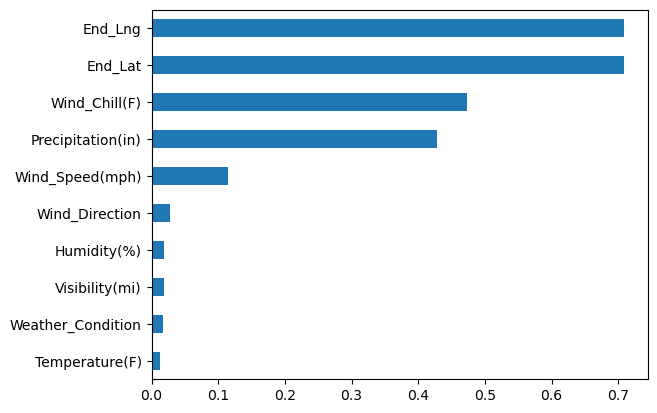

In [31]:
# Calculate the missing value percentage
missing_values_percent = missing_values / len(raw_data)

missing_values_percent_sorted = (
    missing_values_percent
    .head(10)
    .sort_values(ascending = True)
)
# build a bar chart
missing_values_percent_sorted.plot(kind = 'barh')   #horizontal bar chart

### Note： 

There are 4 columns(includes End_lng, End_lat, Wind_chill, and Precipitation) that have missing value more than 40% of total, we should not use them for analysis and visualization.

In [32]:
# keep These columns
cols_to_keep = ['ID', 
                'Severity', 
                'Start_Time', 
                'End_Time', 
                'Start_Lat',
                'Start_Lng', 
                'Distance(mi)',
                'Street', 
                'City', 
                'County', 
                'Zipcode', 
                'Temperature(F)', 
                'Visibility(mi)', 
                'Wind_Speed(mph)', 
                'Weather_Condition', 
                'Sunrise_Sunset', 
]

raw_df = raw_data[cols_to_keep]

# convert column's name into lower case
raw_df.columns = raw_df.columns.str.lower()

# Review
raw_df

,id,severity,start_time,end_time,start_lat,start_lng,distance(mi),street,city,county,zipcode,temperature(f),visibility(mi),wind_speed(mph),weather_condition,sunrise_sunset
0,A-261009,2,2016-11-30 16:03:54,2016-11-30 17:20:00,30.336502,-97.755646,0.010,Mopac Expy S,Austin,Travis,78731,66.0,10.0,5.8,Clear,Day
1,A-261010,2,2016-11-30 16:32:18,2016-11-30 17:47:02,30.328165,-97.694305,0.000,E Saint Johns Ave,Austin,Travis,78752-2826,62.1,10.0,4.6,Clear,Day
2,A-261011,2,2016-11-30 16:31:45,2016-11-30 17:46:34,30.326077,-97.692307,0.000,Cameron Rd,Austin,Travis,78752,62.1,10.0,4.6,Clear,Day
3,A-261028,2,2016-11-30 17:11:22,2016-11-30 17:41:09,30.332523,-97.686707,0.010,US-183 S,Austin,Travis,78752,62.1,10.0,4.6,Clear,Day
4,A-261039,2,2016-11-30 17:16:42,2016-11-30 17:46:32,30.292852,-97.747017,0.010,N Lamar Blvd,Austin,Travis,78705,62.1,10.0,4.6,Clear,Day
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
96599,A-7775008,4,2019-08-18 04:03:40,2019-08-18 04:33:09,30.341300,-97.769622,0.756,Ranch Road 2222,Austin,Travis,78731,81.0,10.0,3.0,Mostly Cloudy,Night
96600,A-7775009,4,2019-08-18 04:03:40,2019-08-18 04:33:09,30.341688,-97.782288,0.756,Butte Blvd,Austin,Travis,78731,81.0,10.0,3.0,Mostly Cloudy,Night
96601,A-7775010,4,2019-08-18 05:18:40,2019-08-18 05:47:20,30.341688,-97.782288,0.756,Butte Blvd,Austin,Travis,78731,80.0,10.0,5.0,Mostly Cloudy,Night
96602,A-7777478,2,2019-08-23 08:34:56,2019-08-23 09:04:52,30.437960,-97.777150,0.778,US-183 S,Austin,Williamson,78750,83.0,10.0,3.0,Mostly Cloudy,Day


### Add the necessary calculation columns.

In [33]:
# Ensure 'Start_Time' and 'End_Time' are in datetime format
raw_df['start_time'] = pd.to_datetime(raw_df['start_time'], errors='coerce', format='mixed')
raw_df['end_time'] = pd.to_datetime(raw_df['end_time'], errors='coerce', format='mixed')

# Calculate duration in minutes
raw_df['duration'] = round((raw_df['end_time'] - raw_df['start_time']).dt.total_seconds() / 60, 0)


# Rename 'Distance(mi)' to 'Distance' for simplicity
raw_df.rename(columns={'distance(mi)': 'distance'}, inplace=True)

# Display the prepared data
raw_df.head()

,id,severity,start_time,end_time,start_lat,start_lng,distance,street,city,county,zipcode,temperature(f),visibility(mi),wind_speed(mph),weather_condition,sunrise_sunset,duration
0,A-261009,2,2016-11-30 16:03:54,2016-11-30 17:20:00,30.336502,-97.755646,0.01,Mopac Expy S,Austin,Travis,78731,66.0,10.0,5.8,Clear,Day,76.0
1,A-261010,2,2016-11-30 16:32:18,2016-11-30 17:47:02,30.328165,-97.694305,0.00,E Saint Johns Ave,Austin,Travis,78752-2826,62.1,10.0,4.6,Clear,Day,75.0
2,A-261011,2,2016-11-30 16:31:45,2016-11-30 17:46:34,30.326077,-97.692307,0.00,Cameron Rd,Austin,Travis,78752,62.1,10.0,4.6,Clear,Day,75.0
3,A-261028,2,2016-11-30 17:11:22,2016-11-30 17:41:09,30.332523,-97.686707,0.01,US-183 S,Austin,Travis,78752,62.1,10.0,4.6,Clear,Day,30.0
4,A-261039,2,2016-11-30 17:16:42,2016-11-30 17:46:32,30.292852,-97.747017,0.01,N Lamar Blvd,Austin,Travis,78705,62.1,10.0,4.6,Clear,Day,30.0


In [34]:
# Convert 'severity' to a categorical variable 
raw_df['severity'] = raw_df['severity'].astype(str)

# Convert 'duration' to categorical variable without units
# Bins: 0 to 30, 30 to 60, 60 to 120, Over 120
duration_bins = [0, 30, 60, 120, raw_df['duration'].max()]
duration_labels = ['0 to 30', '30 to 60', '60 to 120', 'Over 120']
raw_df['duration_category'] = pd.cut(raw_df['duration'], bins=duration_bins, labels=duration_labels, include_lowest=True)

# Convert 'distance' to categorical variable without units
# Bins: 0 to 0.1, 0.1 to 0.5, 0.5 to 1, Over 1
distance_bins = [0, 0.1, 0.5, 1, raw_df['distance'].max()]
distance_labels = ['0 to 0.1', '0.1 to 0.5', '0.5 to 1', 'Over 1']
raw_df['distance_category'] = pd.cut(raw_df['distance'], bins=distance_bins, labels=distance_labels, include_lowest=True)

raw_df

,id,severity,start_time,end_time,start_lat,start_lng,distance,street,city,county,zipcode,temperature(f),visibility(mi),wind_speed(mph),weather_condition,sunrise_sunset,duration,duration_category,distance_category
0,A-261009,2,2016-11-30 16:03:54,2016-11-30 17:20:00,30.336502,-97.755646,0.010,Mopac Expy S,Austin,Travis,78731,66.0,10.0,5.8,Clear,Day,76.0,60 to 120,0 to 0.1
1,A-261010,2,2016-11-30 16:32:18,2016-11-30 17:47:02,30.328165,-97.694305,0.000,E Saint Johns Ave,Austin,Travis,78752-2826,62.1,10.0,4.6,Clear,Day,75.0,60 to 120,0 to 0.1
2,A-261011,2,2016-11-30 16:31:45,2016-11-30 17:46:34,30.326077,-97.692307,0.000,Cameron Rd,Austin,Travis,78752,62.1,10.0,4.6,Clear,Day,75.0,60 to 120,0 to 0.1
3,A-261028,2,2016-11-30 17:11:22,2016-11-30 17:41:09,30.332523,-97.686707,0.010,US-183 S,Austin,Travis,78752,62.1,10.0,4.6,Clear,Day,30.0,0 to 30,0 to 0.1
4,A-261039,2,2016-11-30 17:16:42,2016-11-30 17:46:32,30.292852,-97.747017,0.010,N Lamar Blvd,Austin,Travis,78705,62.1,10.0,4.6,Clear,Day,30.0,0 to 30,0 to 0.1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
96599,A-7775008,4,2019-08-18 04:03:40,2019-08-18 04:33:09,30.341300,-97.769622,0.756,Ranch Road 2222,Austin,Travis,78731,81.0,10.0,3.0,Mostly Cloudy,Night,29.0,0 to 30,0.5 to 1
96600,A-7775009,4,2019-08-18 04:03:40,2019-08-18 04:33:09,30.341688,-97.782288,0.756,Butte Blvd,Austin,Travis,78731,81.0,10.0,3.0,Mostly Cloudy,Night,29.0,0 to 30,0.5 to 1
96601,A-7775010,4,2019-08-18 05:18:40,2019-08-18 05:47:20,30.341688,-97.782288,0.756,Butte Blvd,Austin,Travis,78731,80.0,10.0,5.0,Mostly Cloudy,Night,29.0,0 to 30,0.5 to 1
96602,A-7777478,2,2019-08-23 08:34:56,2019-08-23 09:04:52,30.437960,-97.777150,0.778,US-183 S,Austin,Williamson,78750,83.0,10.0,3.0,Mostly Cloudy,Day,30.0,0 to 30,0.5 to 1


In [35]:
# Checkpoint

austin_df = raw_df.copy()

austin_df

,id,severity,start_time,end_time,start_lat,start_lng,distance,street,city,county,zipcode,temperature(f),visibility(mi),wind_speed(mph),weather_condition,sunrise_sunset,duration,duration_category,distance_category
0,A-261009,2,2016-11-30 16:03:54,2016-11-30 17:20:00,30.336502,-97.755646,0.010,Mopac Expy S,Austin,Travis,78731,66.0,10.0,5.8,Clear,Day,76.0,60 to 120,0 to 0.1
1,A-261010,2,2016-11-30 16:32:18,2016-11-30 17:47:02,30.328165,-97.694305,0.000,E Saint Johns Ave,Austin,Travis,78752-2826,62.1,10.0,4.6,Clear,Day,75.0,60 to 120,0 to 0.1
2,A-261011,2,2016-11-30 16:31:45,2016-11-30 17:46:34,30.326077,-97.692307,0.000,Cameron Rd,Austin,Travis,78752,62.1,10.0,4.6,Clear,Day,75.0,60 to 120,0 to 0.1
3,A-261028,2,2016-11-30 17:11:22,2016-11-30 17:41:09,30.332523,-97.686707,0.010,US-183 S,Austin,Travis,78752,62.1,10.0,4.6,Clear,Day,30.0,0 to 30,0 to 0.1
4,A-261039,2,2016-11-30 17:16:42,2016-11-30 17:46:32,30.292852,-97.747017,0.010,N Lamar Blvd,Austin,Travis,78705,62.1,10.0,4.6,Clear,Day,30.0,0 to 30,0 to 0.1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
96599,A-7775008,4,2019-08-18 04:03:40,2019-08-18 04:33:09,30.341300,-97.769622,0.756,Ranch Road 2222,Austin,Travis,78731,81.0,10.0,3.0,Mostly Cloudy,Night,29.0,0 to 30,0.5 to 1
96600,A-7775009,4,2019-08-18 04:03:40,2019-08-18 04:33:09,30.341688,-97.782288,0.756,Butte Blvd,Austin,Travis,78731,81.0,10.0,3.0,Mostly Cloudy,Night,29.0,0 to 30,0.5 to 1
96601,A-7775010,4,2019-08-18 05:18:40,2019-08-18 05:47:20,30.341688,-97.782288,0.756,Butte Blvd,Austin,Travis,78731,80.0,10.0,5.0,Mostly Cloudy,Night,29.0,0 to 30,0.5 to 1
96602,A-7777478,2,2019-08-23 08:34:56,2019-08-23 09:04:52,30.437960,-97.777150,0.778,US-183 S,Austin,Williamson,78750,83.0,10.0,3.0,Mostly Cloudy,Day,30.0,0 to 30,0.5 to 1


In [36]:
# Calculate the year
austin_df['year'] = austin_df['start_time'].dt.year

# Calculate the month
austin_df['month'] = austin_df['start_time'].dt.month

# Calculate daytype, 0-4 are weekdays (Monday=0, Sunday=6), 5-6 are weekends.
austin_df['day_type'] = austin_df['start_time'].dt.dayofweek.apply(lambda x: 'Weekend' if x >= 5 else 'Weekday')

# Calculate hour
austin_df['hour'] = austin_df['start_time'].dt.hour

# review
print(austin_df[['start_time', 'day_type', 'year', 'month', 'hour']].head())

           start_time day_type  year  month  hour
0 2016-11-30 16:03:54  Weekday  2016     11    16
1 2016-11-30 16:32:18  Weekday  2016     11    16
2 2016-11-30 16:31:45  Weekday  2016     11    16
3 2016-11-30 17:11:22  Weekday  2016     11    17
4 2016-11-30 17:16:42  Weekday  2016     11    17


In [37]:
# Remove the four-digit extension after the hyphen
austin_df['zipcode'] = austin_df['zipcode'].str.split('-').str[0]

austin_df['zipcode'].unique()

array(['78731', '78752', '78705', '78749', '78745', '78758', '78746',
       '78701', '78756', '78722', '78751', '78724', '78732', '78719',
       '78727', '78759', '78754', '78744', '78747', '78757', '78728',
       '78733', '78741', '78738', '78750', '78703', '78730', '78721',
       '78734', '78717', '78702', '78753', '78748', '78704', '78729',
       '78723', '78735', '78736', '78725', '78739', '78726', '78742',
       '78737', '78712', '73301', '78653'], dtype=object)

In [38]:
# Rename column
austin_df.rename(columns={
    'temperature(f)': 'temperature', 
    'visibility(mi)': 'visibility',
    'wind_speed(mph)': 'wind_speed',
}, inplace=True)

austin_df

,id,severity,start_time,end_time,start_lat,start_lng,distance,street,city,county,...,wind_speed,weather_condition,sunrise_sunset,duration,duration_category,distance_category,year,month,day_type,hour
0,A-261009,2,2016-11-30 16:03:54,2016-11-30 17:20:00,30.336502,-97.755646,0.010,Mopac Expy S,Austin,Travis,...,5.8,Clear,Day,76.0,60 to 120,0 to 0.1,2016,11,Weekday,16
1,A-261010,2,2016-11-30 16:32:18,2016-11-30 17:47:02,30.328165,-97.694305,0.000,E Saint Johns Ave,Austin,Travis,...,4.6,Clear,Day,75.0,60 to 120,0 to 0.1,2016,11,Weekday,16
2,A-261011,2,2016-11-30 16:31:45,2016-11-30 17:46:34,30.326077,-97.692307,0.000,Cameron Rd,Austin,Travis,...,4.6,Clear,Day,75.0,60 to 120,0 to 0.1,2016,11,Weekday,16
3,A-261028,2,2016-11-30 17:11:22,2016-11-30 17:41:09,30.332523,-97.686707,0.010,US-183 S,Austin,Travis,...,4.6,Clear,Day,30.0,0 to 30,0 to 0.1,2016,11,Weekday,17
4,A-261039,2,2016-11-30 17:16:42,2016-11-30 17:46:32,30.292852,-97.747017,0.010,N Lamar Blvd,Austin,Travis,...,4.6,Clear,Day,30.0,0 to 30,0 to 0.1,2016,11,Weekday,17
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
96599,A-7775008,4,2019-08-18 04:03:40,2019-08-18 04:33:09,30.341300,-97.769622,0.756,Ranch Road 2222,Austin,Travis,...,3.0,Mostly Cloudy,Night,29.0,0 to 30,0.5 to 1,2019,8,Weekend,4
96600,A-7775009,4,2019-08-18 04:03:40,2019-08-18 04:33:09,30.341688,-97.782288,0.756,Butte Blvd,Austin,Travis,...,3.0,Mostly Cloudy,Night,29.0,0 to 30,0.5 to 1,2019,8,Weekend,4
96601,A-7775010,4,2019-08-18 05:18:40,2019-08-18 05:47:20,30.341688,-97.782288,0.756,Butte Blvd,Austin,Travis,...,5.0,Mostly Cloudy,Night,29.0,0 to 30,0.5 to 1,2019,8,Weekend,5
96602,A-7777478,2,2019-08-23 08:34:56,2019-08-23 09:04:52,30.437960,-97.777150,0.778,US-183 S,Austin,Williamson,...,3.0,Mostly Cloudy,Day,30.0,0 to 30,0.5 to 1,2019,8,Weekday,8


In [39]:
# Save The result
outputs_file_path = './Output_data/austin_time_trends_data.csv'
austin_df.to_csv(outputs_file_path, encoding='utf-8')

## Data Visualization

### Goal：

1. Use Python and  Plotly to explore different visualization charts based on time series and geographical analysis needs.
2. Generate the corresponding JSON files based on the views and create presentation files.

### Fig1: Accidents By Year month(Line Chart)

In [45]:
# Convert 'start_time' column to datetime with error handling
austin_df['start_time'] = pd.to_datetime(austin_df['start_time'], errors='coerce', format='mixed')

# Create 'start_year_month' column for year and month
austin_df['start_year_month'] = austin_df['start_time'].dt.to_period('M')

# Group by 'start_year_month' and 'County' and count the number of accidents
accidents_by_year_month_county = (
    austin_df
    .groupby(['start_year_month', 'county'])
    .size()
    .reset_index(name='accident_count')
)

accidents_by_year_month_county

,start_year_month,county,accident_count
0,2016-06,Travis,550
1,2016-06,Williamson,15
2,2016-07,Hays,1
3,2016-07,Travis,1324
4,2016-07,Williamson,36
...,...,...,...
196,2023-01,Williamson,61
197,2023-02,Travis,541
198,2023-02,Williamson,21
199,2023-03,Travis,402


In [47]:
# Ensure 'start_year_month' is in datetime format for Plotly compatibility
accidents_by_year_month_county['start_year_month'] = accidents_by_year_month_county['start_year_month'].dt.to_timestamp()
# Create a static line chart
fig1 = px.line(
    accidents_by_year_month_county,
    x='start_year_month',
    y='accident_count',
    color='county',
    title='Austin Accidents Trends Over Time by County',
    labels={'start_year_month': 'Year-Month', 'accident_count': 'Number of Accidents'}
)

# Find the start, end, and intermediate points of the data
start_date = accidents_by_year_month_county['start_year_month'].min()
end_date = accidents_by_year_month_county['start_year_month'].max()

# Generate a list of tick values (you can adjust this to control the interval)
tick_values = pd.date_range(start=start_date, end=end_date, freq='10M')

# Convert tick values to strings for custom labels
tick_labels = [date.strftime('%Y-%m') for date in tick_values]

# Update layout for better visualization, add range slider, and customize x-axis labels
fig1.update_layout(
    title={
        'text': 'Austin Accidents Trends Over Time by County',
        'x': 0.5,  # Center the title
        'xanchor': 'center'  # Ensure the title is centered based on the x value
    },
    xaxis_title='Drag the slider to display the trend for a specific time period',
    yaxis_title='Number of Accidents',
    xaxis=dict(
        tickformat='%Y-%m',
        tickvals=tick_values,  # Set the tick values to include start, end, and intermediate dates
        ticktext=tick_labels,  # Set the corresponding labels for each tick
        rangeslider=dict(
            visible=True  # Enable the range slider
        ),
        type='date'  # Ensure the x-axis is treated as a date axis
    ),
    legend=dict(
        orientation="h",  # Horizontal orientation for the legend
        x=0.5,  # Center the legend horizontally
        y=1.02,  # Position the legend above the plot area
        xanchor='center',  # Anchor the legend to the center horizontally
        yanchor='bottom'   # Anchor the legend from the bottom
    )   
)

# Show the plot
fig1.show()

In [48]:
# Convert figures to JSON
fig1_json = pio.to_json(fig1)

# Save JSON data to files
with open('./JSON/fig1.json', 'w') as f:
    f.write(fig1_json)

### Fig 2: Monthly distribution Chart

In [73]:

# Create a list to hold all traces
data = []

# Add an "All" category to show all years combined with a specific color
trace_all = go.Histogram(
    x=austin_df['month'],
    name='All',  # Use "All" as the name
    autobinx=False,
    marker=dict(
        color='rgba(255, 100, 100, 0.7)',  # Specific red color
        line=dict(
            color='rgba(255, 100, 100, 1)',  # Solid red border
            width=1
        )
    ),
    opacity=0.7,
    xbins=dict(
        start=0.5,  # Start before month 1 to ensure all months are captured
        end=12.5,   # End after month 12 to ensure month 12 is included
        size=1
    ),
    visible='legendonly'  # Start with 'All' trace hidden
)

# Add the "All" trace to the data list
data.append(trace_all)

# Sort years in ascending order
sorted_years = sorted(austin_df['year'].unique())

# Loop through each sorted year and create a histogram trace
for year in sorted_years:
    # Filter data for the current year
    yearly_data = austin_df[austin_df['year'] == year]
    
    # Extract month data for the current year
    x_month = yearly_data['month']
    
    # Create histogram trace for the current year
    trace = go.Histogram(
        x=x_month,
        name=str(year),  # Use year as the name
        autobinx=False,
        marker=dict(
            line=dict(
                width=1
            )
        ),
        opacity=0.5,
        xbins=dict(
            start=0.5,  # Start before month 1 to ensure all months are captured
            end=12.5,   # End after month 12 to ensure month 12 is included
            size=1
        ),
        visible=True  # Start with individual years visible
    )
    
    # Add trace to the data list
    data.append(trace)

# Define layout with custom legend behavior
layout = go.Layout(
    bargap=0.05,
    bargroupgap=0.2,
    barmode='overlay',  # Use 'overlay' for transparent bars
    title={
        'text': 'Monthly Distribution of Accidents for Each Year',
        'x': 0.5,  # Center the title
        'xanchor': 'center'  # Ensure the title is centered based on the x value
    },
    xaxis=dict(
        title='Month',
        tickmode='array',
        tickvals=[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12],
        ticktext=['Jan', 'Feb', 'Mar', 'Apr', 'May', 'Jun', 'Jul', 'Aug', 'Sep', 'Oct', 'Nov', 'Dec'],
        range=[0.5, 12.5]  # Adjust range to include all months
    ),
    yaxis=dict(title='Count'),
    legend=dict(
        title='Year Selector',
        itemsizing='constant'
    )
)

# Create figure
fig2 = go.Figure(data=data, layout=layout)

# Add buttons to update trace visibility
fig2.update_layout(
    updatemenus=[
        dict(
            type="buttons",
            direction="right",
            buttons=list([
                dict(
                    args=[{"visible": [True] + [False] * len(sorted_years)}],
                    label="Show All",
                    method="update"
                ),
                dict(
                    args=[{"visible": [False] + [True] * len(sorted_years)}],
                    label="Select Years",
                    method="update"
                )
            ]),
            pad={"r": 10, "t": 10},
            showactive=True,
            x=0.55,  # Center the buttons horizontally above the legend
            xanchor="center",
            y=1.05,  # Position the buttons above the plot area
            yanchor="top"
        )
    ]
)

# Show the plot
fig2.show()


In [74]:
# Convert figures to JSON
fig2_json = pio.to_json(fig2)

# Save JSON data to files
with open('./JSON/fig2.json', 'w') as f:
    f.write(fig2_json)

### Fig 3: Hourly Distribution Chart

In [77]:
# Separate data into Weekday and Weekend
weekday_data = austin_df[austin_df['day_type'] == 'Weekday']
weekend_data = austin_df[austin_df['day_type'] == 'Weekend']

# Calculate the average number of accidents per hour for Weekdays and Weekends
weekday_avg = weekday_data.groupby('hour').size() / 5  # Average over 5 days
weekend_avg = weekend_data.groupby('hour').size() / 2  # Average over 2 days
overall_avg = austin_df.groupby('hour').size() / 7  # Average over 7 days

# Create bar traces for Weekdays and Weekends
trace_weekday = go.Bar(
    x=weekday_avg.index,
    y=weekday_avg,
    name='Weekday',
    marker=dict(
        color='rgba(255, 100, 102, 0.7)',  # Transparent red
        line=dict(
            color='rgba(255, 100, 102, 1)',  # Solid red border
            width=1
        )
    ),
    opacity=0.5,
    visible=False  # Initially hidden
)

trace_weekend = go.Bar(
    x=weekend_avg.index,
    y=weekend_avg,
    name='Weekend',
    marker=dict(
        color='rgba(100, 200, 102, 0.7)',  # Transparent green
        line=dict(
            color='rgba(100, 200, 102, 1)',  # Solid green border
            width=1
        )
    ),
    opacity=0.5,
    visible=False  # Initially hidden
)

# Create a bar trace for Overall average
trace_overall = go.Bar(
    x=overall_avg.index,
    y=overall_avg,
    name='Overall',
    marker=dict(
        color='rgba(150, 150, 255, 0.7)',  # Transparent blue
        line=dict(
            color='rgba(150, 150, 255, 1)',  # Solid blue border
            width=1
        )
    ),
    opacity=0.5,
    visible=True  # Initially visible
)

# Combine traces
data = [trace_overall, trace_weekday, trace_weekend]

# Define layout with adjusted x-axis range and bar width
layout = go.Layout(
    width=1200,  # Set plot width to fit within 1440px screen width
    height=600,  # Set plot height to fit within 900px screen height
    bargap=0.05,
    bargroupgap=0.2,
    barmode='overlay',  # Overlay bars to show both groups transparently
    title={
        'text': 'Average Number of Accidents by Hour and Day Typ',
        'x': 0.5,  # Center the title
        'xanchor': 'center'  # Ensure the title is centered based on the x value
    },
    xaxis=dict(
        title='Hour of Day', 
        range=[-0.5, 23.5]  # Adjust range to add padding on both sides
    ),
    yaxis=dict(title='Average Number of Accidents per Hour'),
    updatemenus=[
        dict(
            type="buttons",
            direction="right",
            buttons=list([
                dict(
                    args=[{"visible": [True, False, False]}, {"title": "Overall Distribution of Accidents by Hour"}],
                    label="Show All",
                    method="update"
                ),
                dict(
                    args=[{"visible": [False, True, True]}, {"title": "Detailed Distribution: Weekday vs Weekend"}],
                    label="Details",
                    method="update"
                )
            ]),
            pad={"r": 10, "t": 10},
            showactive=True,
            x=0.5,  # Center the buttons horizontally above the legend
            xanchor="center",
            y=1.1,  # Position the buttons above the plot area
            yanchor="top"
        ),
    ],
    margin={"l": 100, "r": 100, "t": 150, "b": 100}  # Set margins to ensure all elements are visible
)

# Create figure
fig3 = go.Figure(data=data, layout=layout)

# Show the plot
fig3.show()


In [79]:
# Convert figures to JSON
fig3_json = pio.to_json(fig3)

# Save JSON data to files
with open('./JSON/fig3.json', 'w') as f:
    f.write(fig3_json)

### Fig 4: Bubble Chart of Accidents by Zipcode

In [58]:
# Aggregate data to count the number of accidents per 'zipcode' for each 'start_year_month'
accidents_per_month = (
    austin_df.groupby(['start_year_month', 'zipcode'])
    .size()
    .reset_index(name='accident_count')
)

# Ensure 'start_year_month' is in datetime format for proper sorting and animation
accidents_per_month['start_year_month'] = accidents_per_month['start_year_month'].dt.to_timestamp()

# review
accidents_per_month 

,start_year_month,zipcode,accident_count
0,2016-06-01,78701,21
1,2016-06-01,78702,14
2,2016-06-01,78703,13
3,2016-06-01,78704,44
4,2016-06-01,78705,9
...,...,...,...
3521,2023-03-01,78754,10
3522,2023-03-01,78756,8
3523,2023-03-01,78757,5
3524,2023-03-01,78758,24


In [90]:
# Create the bubble chart using Plotly Express
fig4 = px.scatter(
    accidents_per_month,
    x='zipcode',
    y='accident_count',
    size='accident_count',  # Bubble size represents the accident count
    color='zipcode',  # Different colors for each zipcode
    animation_frame='start_year_month',  # Animation over time
    range_y=[0, accidents_per_month['accident_count'].max() + 10],  # Set a reasonable y-axis range
    title='Accident Counts per Zipcode Over Time',
    labels={'accident_count': 'Number of Accidents', 'zipcode': 'Zipcode', 'start_year_month': 'Year-Month'}
)

# Update layout to center the title and improve aesthetics
fig4.update_layout(
    title={
        'text': 'Accident Counts per Zipcode Over Time',
        'x': 0.5,  # Center the title
        'xanchor': 'center'
    },
    xaxis_title='Zipcode',
    yaxis_title='Number of Accidents',
    margin={"r": 150, "t": 50, "l": 50, "b": 50},  # Adjust margins
)

# Show the plot
fig4.show()

In [91]:
# Convert figures to JSON
fig4_json = pio.to_json(fig4)

# Save JSON data to files
with open('./JSON/fig4.json', 'w') as f:
    f.write(fig4_json)

### Fig 5: Accident Distribution Map by Severity

In [20]:
# Select relevant columns for analysis
geo_data = austin_df[['id', 'street', 'county', 'zipcode', 'start_lat', 'start_lng', 'severity', 'duration', 'distance']]


# Display the prepared data
geo_data.head()

# Convert 'severity' to a categorical variable (if not already done)
geo_data['severity'] = geo_data['severity'].astype(str)

# Convert 'duration' to categorical variable without units
# Bins: 0 to 30, 30 to 60, 60 to 120, Over 120
duration_bins = [0, 30, 60, 120, geo_data['duration'].max()]
duration_labels = ['0 to 30', '30 to 60', '60 to 120', 'Over 120']
geo_data['duration_category'] = pd.cut(geo_data['duration'], bins=duration_bins, labels=duration_labels, include_lowest=True)

# Convert 'distance' to categorical variable without units
# Bins: 0 to 0.1, 0.1 to 0.5, 0.5 to 1, Over 1
distance_bins = [0, 0.1, 0.5, 1, geo_data['distance'].max()]
distance_labels = ['0 to 0.1', '0.1 to 0.5', '0.5 to 1', 'Over 1']
geo_data['distance_category'] = pd.cut(geo_data['distance'], bins=distance_bins, labels=distance_labels, include_lowest=True)

geo_data

,id,street,county,zipcode,start_lat,start_lng,severity,duration,distance,duration_category,distance_category
0,A-261009,Mopac Expy S,Travis,78731,30.336502,-97.755646,2,76.0,0.010,60 to 120,0 to 0.1
1,A-261010,E Saint Johns Ave,Travis,78752,30.328165,-97.694305,2,75.0,0.000,60 to 120,0 to 0.1
2,A-261011,Cameron Rd,Travis,78752,30.326077,-97.692307,2,75.0,0.000,60 to 120,0 to 0.1
3,A-261028,US-183 S,Travis,78752,30.332523,-97.686707,2,30.0,0.010,0 to 30,0 to 0.1
4,A-261039,N Lamar Blvd,Travis,78705,30.292852,-97.747017,2,30.0,0.010,0 to 30,0 to 0.1
...,...,...,...,...,...,...,...,...,...,...,...
96599,A-7775008,Ranch Road 2222,Travis,78731,30.341300,-97.769622,4,29.0,0.756,0 to 30,0.5 to 1
96600,A-7775009,Butte Blvd,Travis,78731,30.341688,-97.782288,4,29.0,0.756,0 to 30,0.5 to 1
96601,A-7775010,Butte Blvd,Travis,78731,30.341688,-97.782288,4,29.0,0.756,0 to 30,0.5 to 1
96602,A-7777478,US-183 S,Williamson,78750,30.437960,-97.777150,2,30.0,0.778,0 to 30,0.5 to 1


In [88]:
# Define a custom color scale with specific colors
# 1 -> Light Grey, 2 -> Light Blue, 3 -> Yellow, 4 -> Red
color_scale = ['#D3D3D3', '#5DADE2', '#FFFF00', '#FF0000']

# Create the scatter map using OpenStreetMap as the base layer
fig5 = px.scatter_mapbox(
    geo_data, 
    lat='start_lat', 
    lon='start_lng', 
    hover_data={'county': True, 'street': True,'zipcode': True,'duration': True, 'distance': True},
    color='severity',  
    category_orders={"severity": ['1', '2', '3', '4']},
    color_discrete_sequence=color_scale,  
    size_max=15,
    zoom=10, 
    title="Accident Distribution Map by Severity" 
)

# Update layout to adjust margins and ensure the title is displayed
fig5.update_layout(
    mapbox_style='open-street-map',
    legend_title_text='Severity Levels',
    margin={"r": 0, "t": 50, "l": 0, "b": 0}, 
    autosize=True,  # Enable autosize
    width=1280,     # Set a default width
    height=720,     # Set a default height
    title={
        'text': 'Accident Distribution Map by Severity',
        'x': 0.5,
        'xanchor': 'center'
    },
    legend=dict(
        orientation="h",
        x=0.5,  # Center the legend horizontally
        y=-0.1,  # Position the legend below the plot area
        xanchor='center',
        yanchor='top'  # Adjust the y-anchor to prevent overlap
    )
)

In [89]:
# Convert figures to JSON
fig5_json = pio.to_json(fig5)

# Save JSON data to files
with open('./JSON/fig5.json', 'w') as f:
    f.write(fig5_json)